In [1]:
# Imports
import matplotlib.pyplot as plt
import matplotlib.image as mpimg
import numpy as np
import cv2
import glob
import math
import pickle

from moviepy.editor import VideoFileClip
from IPython.display import HTML
from scipy.signal import find_peaks_cwt
from time import time

%matplotlib inline

print('Imports imported')

Imports imported


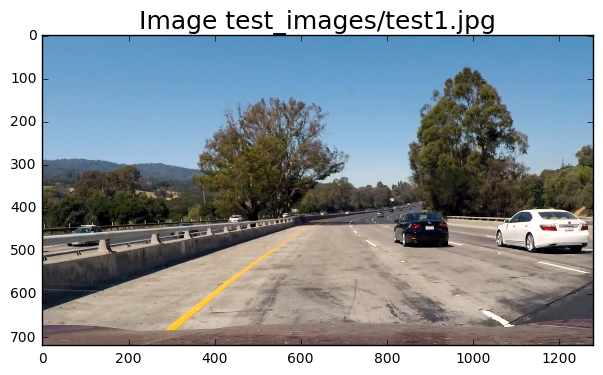

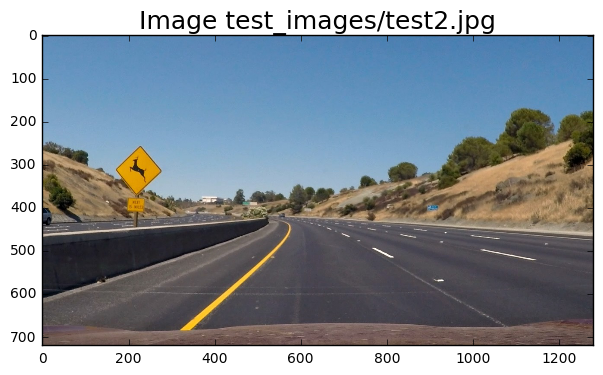

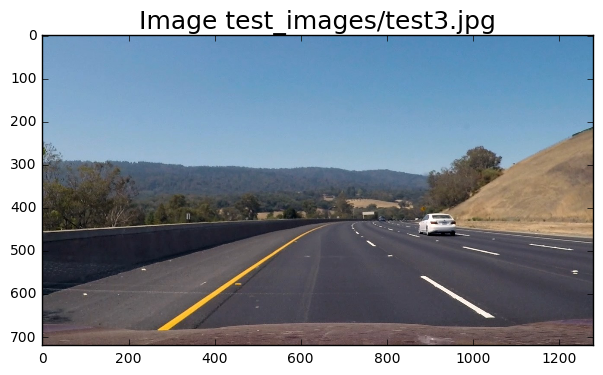

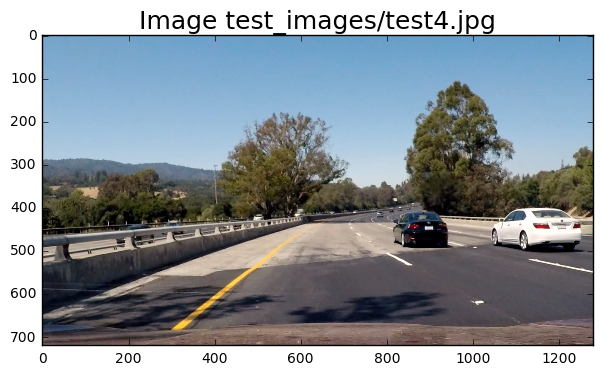

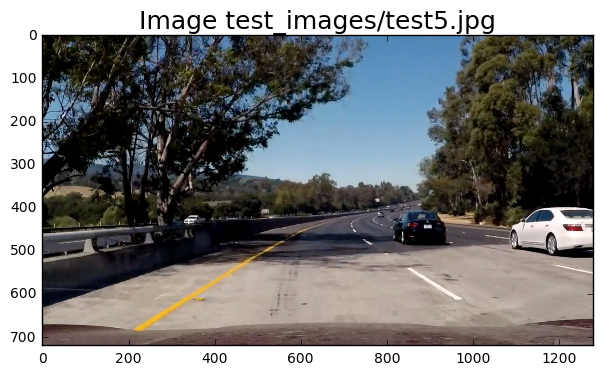

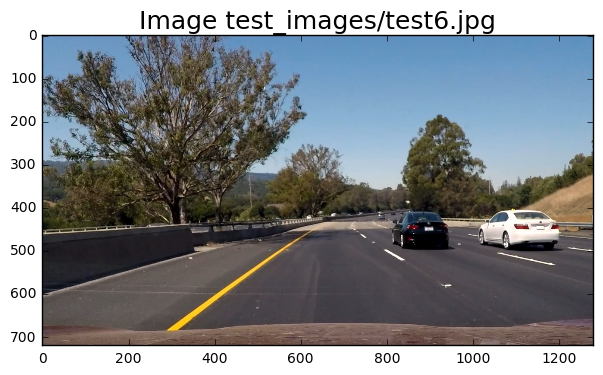

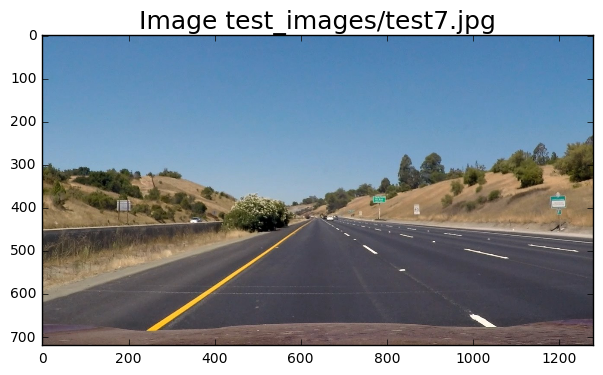

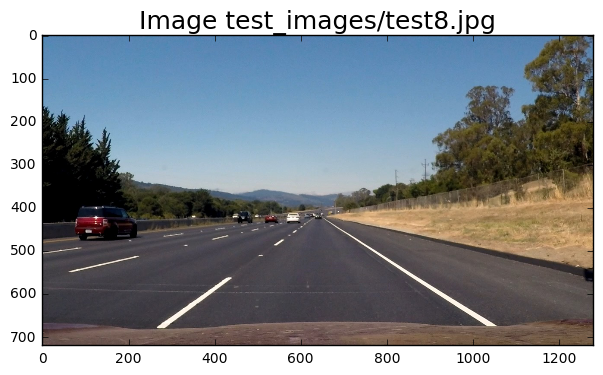

In [2]:
# Visualize Data
# Glob api reads in all the images, must have consistant file name.
images = glob.glob('test_images/test*.jpg')

# Loop through each calibration image
for image, fname in enumerate(images):
    image = mpimg.imread(fname)
    f, (ax1) = plt.subplots(1,1, figsize=(8,4))
#     ax1.imshow(cv2.cvtColor(mpimg.imread(fname), cv2.COLOR_BGR2RGB))
    ax1.imshow(image)
    ax1.set_title('Image '+fname+'', fontsize=18)



In [3]:
# Helper Functions

# prepare object points
nx = 9 # The number of inside corners in x
ny = 6 # The number of inside corners in y

def grayscale(img):
    return cv2.cvtColor(img, cv2.COLOR_RGB2GRAY)

def canny(img, low_threshold, high_threshold):
    """Applies the Canny transform"""
    return cv2.Canny(img, low_threshold, high_threshold)

def gaussian_blur(img, kernel_size):
    """Applies a Gaussian Noise kernel"""
    return cv2.GaussianBlur(img, (kernel_size, kernel_size), 0)

def region_of_interest(img, vertices):
    """
    Applies an image mask.
    
    Only keeps the region of the image defined by the polygon
    formed from `vertices`. The rest of the image is set to black.
    """
    #defining a blank mask to start with
    mask = np.zeros_like(img)   
    
    #defining a 3 channel or 1 channel color to fill the mask with depending on the input image
    if len(img.shape) > 2:
        channel_count = img.shape[2]  # i.e. 3 or 4 depending on your image
        ignore_mask_color = (255,) * channel_count
    else:
        ignore_mask_color = 255
        
    #filling pixels inside the polygon defined by "vertices" with the fill color    
    cv2.fillPoly(mask, vertices, ignore_mask_color)
    
    #returning the image only where mask pixels are nonzero
    masked_image = cv2.bitwise_and(img, mask)
    return masked_image

def draw_lines(img, vertices):
    color = [250,0,0]
    thickness = 20
    lines = []
    line_1 = cv2.line(img, (200,750),(425, 500), color, thickness)
    line_2 = cv2.line(img, (750, 425), (1200,750), color, thickness)
    lines.append(line_1)
    lines.append(line_2)

def hough_lines(img, rho, theta, threshold, min_line_len, max_line_gap):

    """
    `img` should be the output of a Canny transform.
        
    Returns an image with hough lines drawn.
    """
    lines = cv2.HoughLinesP(img, rho, theta, threshold, np.array([]), minLineLength=min_line_len, maxLineGap=max_line_gap)
    line_img = np.zeros((*img.shape, 3), dtype=np.uint8)
    draw_lines(line_img, lines)
    return line_img

def weighted_img(img, initial_img, α=0.8, β=1., λ=0.):
    """
    `img` is the output of the hough_lines(), An image with lines drawn on it.
    Should be a blank image (all black) with lines drawn on it.
    
    `initial_img` should be the image before any processing.
    
    The result image is computed as follows:
    
    initial_img * α + img * β + λ
    NOTE: initial_img and img must be the same shape!
    """
    return cv2.addWeighted(initial_img, α, img, β, λ)

# Correct for distortion
def cal_undistort(img, objpoints, imgpoints):
    ret,mtx,dist,rvecs,tvecs = cv2.calibrateCamera(objpoints, imgpoints, gray.shape[::-1],None, None)
    undistorted_image = cv2.undistort(img,mtx,dist,None,mtx)
    return undistorted_image

def warp(img):
    img_size = (img.shape[1], img.shape[0])
    src = np.float32([ [700,450],[1200,720],[200,720],[575,450] ])
    dst = np.float32([ [1000,0],[1200,720],[400,720],[400,0] ])
    
    M = cv2.getPerspectiveTransform(src, dst)
    
    warped = cv2.warpPerspective(img, M, img_size, flags=cv2.INTER_LINEAR)

    return warped

# 33. Finding the Lines
def get_hist(img):
    histogram = np.sum(img[img.shape[0]/2:,:], axis=0)
    return histogram

# Region of interest
### Code taken directly from project 1.
def region_of_interest(img, vertices):
    """
    Applies an image mask.
    
    Only keeps the region of the image defined by the polygon
    formed from `vertices`. The rest of the image is set to black.
    """

    #defining a blank mask to start with
    mask = np.zeros_like(img)   
    
    #defining a 3 channel or 1 channel color to fill the mask with depending on the input image
    if len(img.shape) > 2:
        channel_count = img.shape[2]  # i.e. 3 or 4 depending on your image
        ignore_mask_color = (255,) * channel_count
    else:
        ignore_mask_color = 255
        
    #filling pixels inside the polygon defined by "vertices" with the fill color    
    cv2.fillPoly(mask, vertices, ignore_mask_color)
    
    #returning the image only where mask pixels are nonzero
    masked_image = cv2.bitwise_and(img, mask)
    
    return masked_image


def cvt_hls(image):
    hls = cv2.cvtColor(image, cv2.COLOR_RGB2HLS)
    s = hls[:,:,2]
    return s

def hls_select(img, thresh=(0, 255)):
    hls_image = cvt_hls(img)
    binary_output = np.zeros_like(hls_image)
    # 2) Apply a threshold to the S channel
    binary_output[(hls_image > thresh[0]) & (hls_image <= thresh[1])] = 1 
    return binary_output

def create_binary(image):
    gray = grayscale(image)
    sobelx = cv2.Sobel(gray, cv2.CV_64F, 1, 0)
    sobely = cv2.Sobel(gray, cv2.CV_64F, 0, 1)
    abs_sobelx = np.absolute(sobelx)
    scaled_sobel = np.uint8(255*abs_sobelx/np.max(abs_sobelx))
    thresh_min = 20
    thresh_max = 100
    sxbinary = np.zeros_like(scaled_sobel)
    sxbinary[(scaled_sobel >= thresh_min) & (scaled_sobel <= thresh_max)] = 1
    return sxbinary
    
print("Region of interest set")
print("Helper functions loaded")

Region of interest set
Helper functions loaded


This image is: <class 'numpy.ndarray'> with dimesions: (720, 1280, 3)


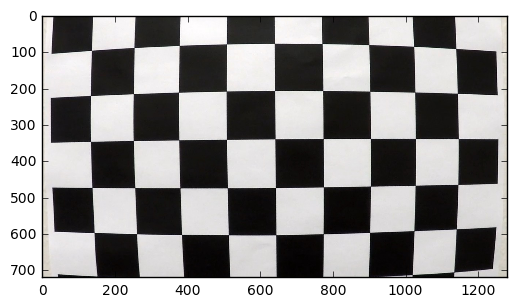

In [4]:
# Calibrate Camera
#### Stage 10
cal_image = mpimg.imread('camera_cal/calibration1.jpg')
#printing out some stats and plotting
print('This image is:', type(cal_image), 'with dimesions:', cal_image.shape)
plt.imshow(cal_image)  #call as plt.imshow(gray, cmap='gray') to show a grayscaled image

In [5]:
# Calibrate Camera
# Draw lines on the chessboard, taken from slide 9. Finding Corners from the lesson.
objpoints = [] # 3d points in real world space.  Should all be the same. (See 10 - Calibrating Camera)
imgpoints = [] # 2d points in image plane.

objp = np.zeros((6*9,3), np.float32) # Needs to be 9, not 8 like in the video.
objp[:,:2] = np.mgrid[0:9, 0:6].T.reshape(-1,2)

# Glob api reads in all the images, must have consistant file name.
images = glob.glob('camera_cal/calibration*.jpg')

# Loop through each calibration image
for image, fname in enumerate(images):
    
    img = cv2.imread(fname)
    gray = grayscale(img)

    # Find the chessboard corners.  This allows us to get coordinates of corners on distorted image.
    ret, corners = cv2.findChessboardCorners(gray, (9,6), None)

    # If found, add object points and image points
    if ret == True:
        objpoints.append(objp)
        imgpoints.append(corners)
        # Draw and display the corners
        cv2.drawChessboardCorners(img, (9,6), corners, ret)
#         write_name = 'corners_found_'+str(image)+'.jpg'
#         cv2.imwrite(write_name, image)

# Test undistortion on an image
img = cv2.imread('camera_cal/calibration2.jpg')
img_size = (img.shape[1], img.shape[0])

# Camera calibration with object points and image points
ret, mtx, dist, rvecs, tvecs = cv2.calibrateCamera(objpoints, imgpoints, img_size,None,None)

dist_pickle = {}
dist_pickle["mtx"] = mtx
dist_pickle["dist"] = dist
pickle.dump( dist_pickle, open( "camera_cal/calibration_pickle.p", "wb" ) )

#         f, (ax1, ax2) = plt.subplots(1, 2, figsize=(8,4))
#         ax1.imshow(cv2.cvtColor(mpimg.imread(fname), cv2.COLOR_BGR2RGB))
#         ax1.set_title('Original Image', fontsize=18)
#         ax2.imshow(cv2.cvtColor(img, cv2.COLOR_BGR2RGB))
#         ax2.set_title('With Corners', fontsize=18)

print('Corners detected, calibrations saved.')

Corners detected, calibrations saved.


In [6]:
# # Test undistortion on an image
# fname = 'camera_cal/calibration{}.jpg'.format(2)
# img = cv2.imread(fname)
# img_size = (img.shape[1], img.shape[0])

# # Camera calibration with object points and image points
# ret, mtx, dist, rvecs, tvecs = cv2.calibrateCamera(objpoints, imgpoints, img_size,None,None)

# dst = cv2.undistort(img, mtx, dist, None, mtx)
# cv2.imwrite('calibration_wide/test_undist.jpg',dst)

# # Save the camera calibration result for later use (we won't worry about rvecs / tvecs)
# dist_pickle = {}
# dist_pickle["mtx"] = mtx
# dist_pickle["dist"] = dist
# pickle.dump( dist_pickle, open( "wide_dist_pickle.p", "wb" ) )

# # Visualize undistortion
# f, (ax1, ax2) = plt.subplots(1, 2, figsize=(20,10))
# ax1.imshow(img)
# ax1.set_title('Original Image', fontsize=15)
# ax2.imshow(dst)
# ax2.set_title('Undistorted Image', fontsize=15)

# print("Calibrations saved")

All images undistorted


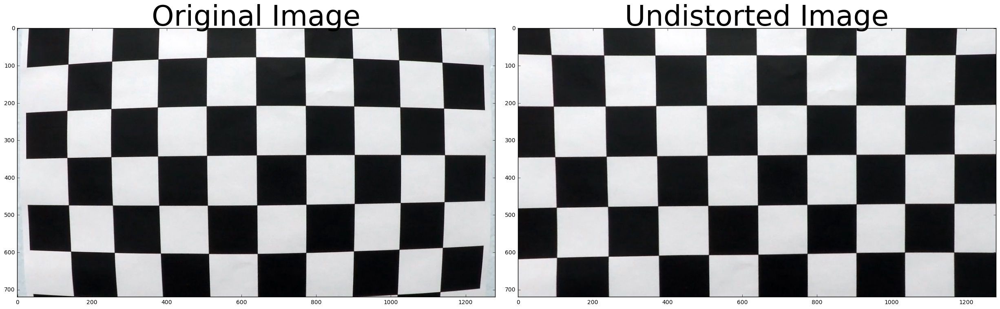

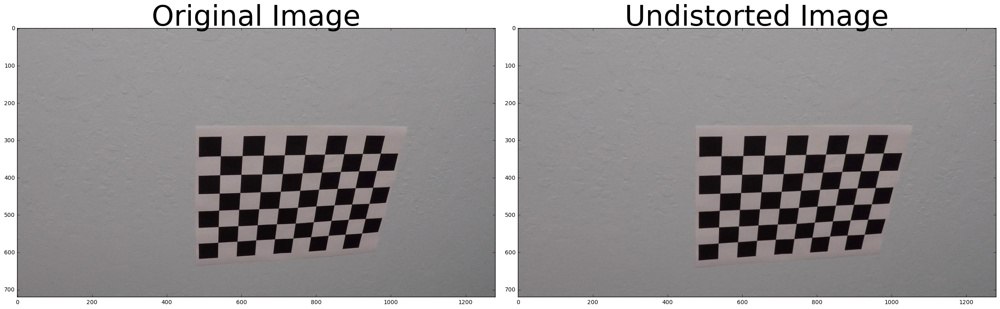

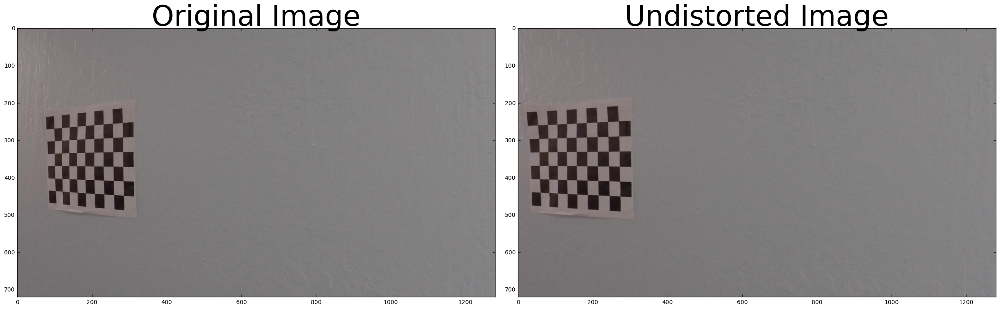

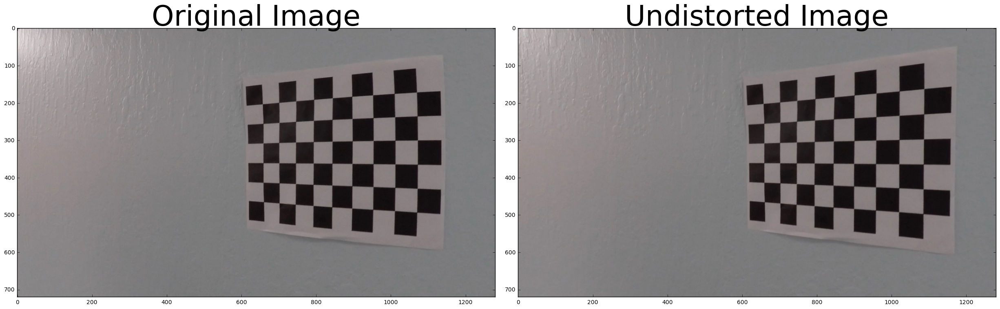

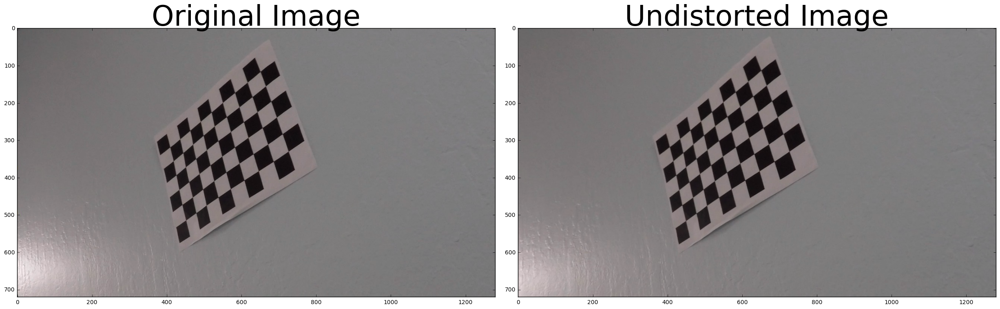

...

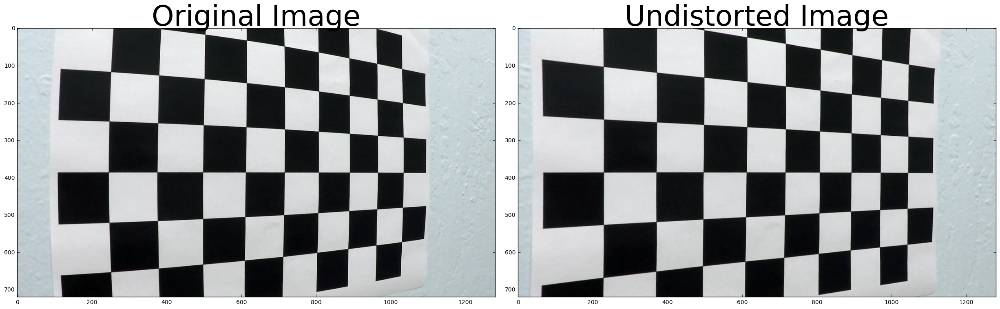

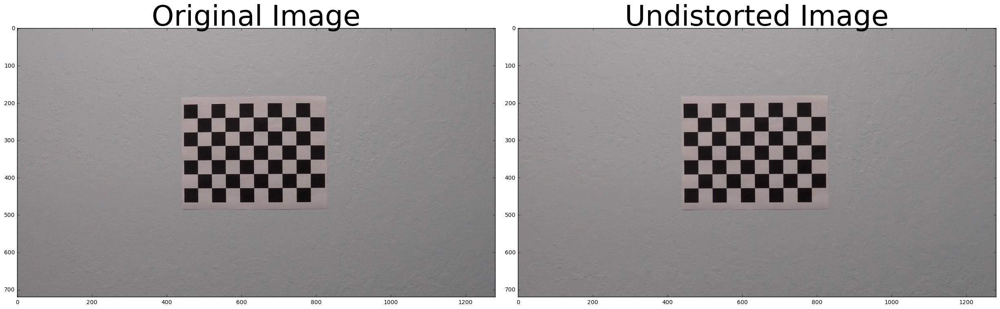

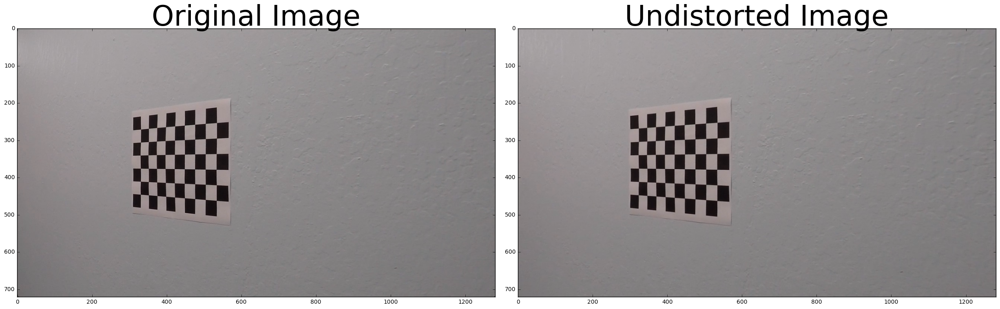

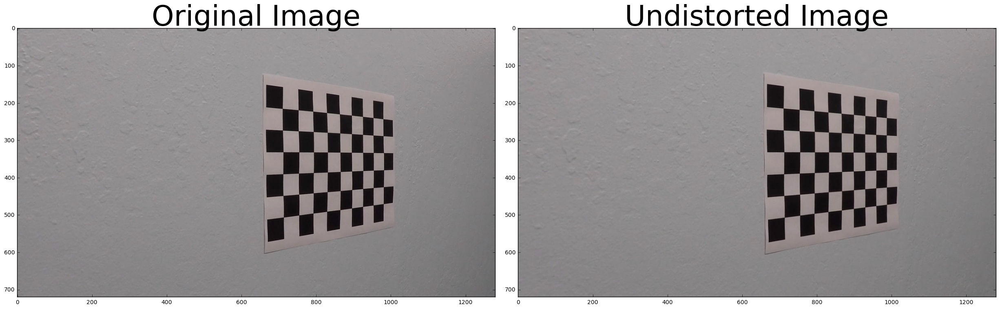

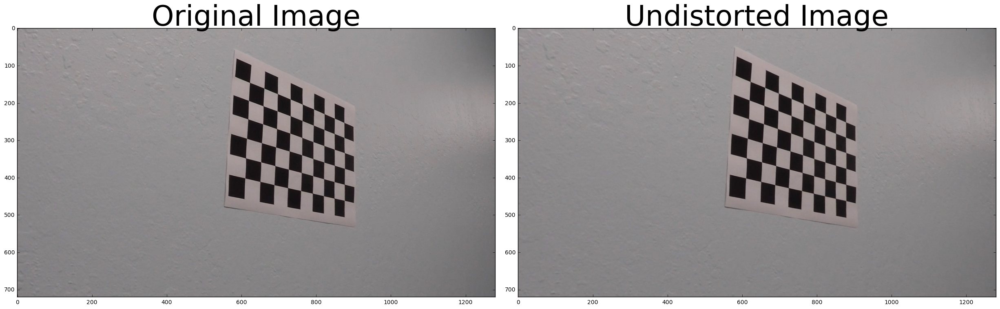

In [7]:
# Loop through and display each undistorted image.
for image, fname in enumerate(images):
    
    img = cv2.imread(fname)
    
    undistorted = cal_undistort(img, objpoints, imgpoints)

    f, (ax1, ax2) = plt.subplots(1, 2, figsize=(24, 9))
    f.tight_layout()
    ax1.imshow(img)
    ax1.set_title('Original Image', fontsize=50)
    ax2.imshow(undistorted)
    ax2.set_title('Undistorted Image', fontsize=50)
    plt.subplots_adjust(left=0., right=1, top=0.9, bottom=0.)
    
print('All images undistorted')

In [8]:
# Functions

# Grayscale
def grayscale(img):
    return cv2.cvtColor(img, cv2.COLOR_RGB2GRAY)

# Sobel
### Code taken from stage 21 "Applying Sobel"
def abs_sobel_thresh(image, orient='x', sobel_kernel=3, thresh=(0, 255)):
    
    # Grayscale the image
    gray = grayscale(image)
    
    # Apply x or y gradient
    if orient == 'x':
        sobel = cv2.Sobel(gray, cv2.CV_64F, 1, 0, ksize=sobel_kernel)
    elif orient == 'y':
        sobel = cv2.Sobel(gray, cv2.CV_64F, 0, 1, ksize=sobel_kernel)
        
    # Take the absolute values
    sobel = np.absolute(sobel)
    
    # Rescale back to 8 bit integer
    scaled_sobel = np.uint8(255*sobel/np.max(sobel))
    
    # Create a copy and apply the threshold
    binary_output = np.zeros_like(scaled_sobel)
    binary_output[(scaled_sobel > thresh[0]) & (scaled_sobel < thresh[1])] = 1
    plt.imshow(binary_output)
    # Return the result
    return binary_output

# Magnitude
### Code take from stage 22
def mag_thresh(image, sobel_kernel=3, mag_thresh=(0, 255)):
    
    # 1 grayscale image
    gray = grayscale(image)
    
    # 2) Take both Sobel x and y gradients
    sobelx = cv2.Sobel(gray, cv2.CV_64F, 1, 0, ksize=sobel_kernel)
    sobely = cv2.Sobel(gray, cv2.CV_64F, 0, 1, ksize=sobel_kernel)
    
    # 3) Calculate the gradient magnitude
    gradmag = np.sqrt(sobelx ** 2 + sobely ** 2)
    
    # 4) Rescale to 8 bit 
    scale_factor = np.max(gradmag)/255 
    gradmag = (gradmag/scale_factor).astype(np.uint8) 
    
    # 5) Create a binary image of ones where threshold is met, zeros otherwise
    binary_output = np.zeros_like(gradmag)
    binary_output[(gradmag >= mag_thresh[0]) & (gradmag <= mag_thresh[1])] = 1
    plt.imshow(binary_output)
    return binary_output

# Calculate gradient direction
### Code taken from stage 23, "Direction of the Gradient"
def dir_threshold(image, sobel_kernel=3, thresh=(0, np.pi/2)):
    
    # 1 grayscale image
    gray = grayscale(image)
    
    # 2) Take the gradient in x and y separately
    sobelx = cv2.Sobel(gray, cv2.CV_64F, 1, 0, ksize=sobel_kernel)
    sobely = cv2.Sobel(gray, cv2.CV_64F, 0, 1, ksize=sobel_kernel)
    
    # 3) Error statement to ignore division and invalid errors
    direction = np.arctan(np.absolute(sobely),np.absolute(sobelx))
    binary_output =  np.zeros_like(direction)
    binary_output[(direction >= thresh[0]) & (direction <= thresh[1])] = 1
    plt.imshow(binary_output)
    # Return the result
    return binary_output

def color_threshold(image, sthresh=(0,255), vthresh=(0,255)):
    
    hls = cv2.cvtColor(image, cv2.COLOR_RGB2HLS)
    s_channel = hls[:,:,2]
    s_binary = np.zeros_like(s_channel)
    s_binary[ (s_channel >= sthresh[0]) & (s_channel <= sthresh[1]) ] = 1
    
    hsv = cv2.cvtColor(image, cv2.COLOR_RGB2HSV)
    v_channel = hsv[:,:,2]
    v_binary = np.zeros_like(v_channel)
    v_binary[ (v_channel >= vthresh[0]) & (v_channel <= vthresh[1] ) ] = 1
    
    output = np.zeros_like(s_channel)
    output[(s_binary == 1) & (v_binary == 1) ] = 1
    
    return output
    
def window_mask(width, height, img_ref, center, level):
    output = np.zeros_like(img_ref)
    output[int(img.shape[0] - (level + 1) * height):int(img_ref.shape[0] - level * height), max(0, int(center * width)):min(int(center + width), img_ref.shape[1]) ] = 1
    return output
    
print("Functions loaded")

Functions loaded


In [9]:
# Define a class to receive the characteristics of each line detection
# Code tacken directly from the walk through video 
class Tracker():
    def __init__(self, Mywindow_width, Mywindow_height, Mymargin, My_ym = 1, My_xm = 1, Mysmooth_factor = 15):
        
        self.recent_centers = []
        self.window_width = Mywindow_width
        self.window_height = Mywindow_height
        self.margin = Mymargin
        self.ym_per_pix = My_ym
        self.xm_per_pix = My_xm
        self.smooth_factor = Mysmooth_factor
        
    def find_window_centroids(self, warped):
        
        window_width = self.window_width
        window_height = self.window_height
        margin = self.margin
        
        # Storing [left,right] pairs
        window_centroids = []
        window = np.ones(window_width)
        
        l_sum = np.sum(warped[int(3 * warped.shape[0] / 4):,:int(warped.shape[1] / 2)], axis=0)
        l_center = np.argmax(np.convolve(window,l_sum)) - window_width / 2
        
        r_sum = np.sum(warped[int(3 * warped.shape[0] / 4):,int(warped.shape[1] / 2):], axis=0)
        r_center = np.argmax(np.convolve(window,r_sum)) - window_width / 2 + int(warped.shape[1] / 2)
        
        window_centroids.append((l_center, r_center))
        
        for level in range(1,(int)(warped.shape[0]/window_height)):
           
            image_layer =  np.sum(warped[int(warped.shape[0] - (level + 1) * window_height):int(warped.shape[0] - level * window_height),:], axis=0)
            conv_signal = np.convolve(window, image_layer)
            
            offset = window_width / 2
            
            l_min_index = int(max(l_center + offset - margin, 0))
            l_max_index = int(min(l_center + offset + margin, warped.shape[1]))
            l_center = np.argmax(conv_signal[l_min_index:l_max_index]) + l_min_index - offset
            
            r_min_index = int(max(r_center + offset - margin, 0))
            r_max_index = int(min(r_center + offset + margin, warped.shape[1]))
            r_center = np.argmax(conv_signal[r_min_index:r_max_index]) + r_min_index - offset
            
            window_centroids.append((l_center,r_center))
            
        self.recent_centers.append(window_centroids)
        
        return np.average(self.recent_centers[-self.smooth_factor:], axis=0)
        
print("Tracker class is defined")

Tracker class is defined


Undistorted images saved.


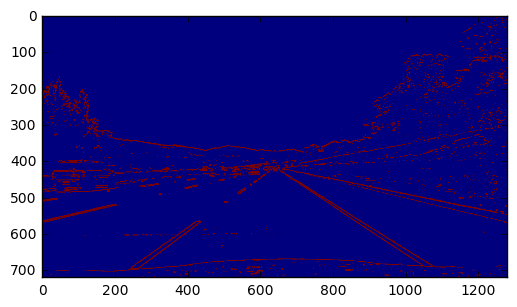

In [10]:
# Undistort the test images
dist_pickle = pickle.load(open("./camera_cal/calibration_pickle.p", "rb"))
mtx = dist_pickle["mtx"]
dist = dist_pickle["dist"]

# Glob api reads in all the images, must have consistant file name.
images = glob.glob('test_images/test*.jpg')

# Loop through each calibration image
for index, fname in enumerate(images):

    img = cv2.imread(fname)

    img = cv2.undistort(img, mtx, dist, None, mtx)
    
    preprocessImage = np.zeros_like(img[:,:,0])
    gradx = abs_sobel_thresh(img, orient='x', thresh=(12,255))
    grady = abs_sobel_thresh(img, orient='y', thresh=(25,255))
    c_binary = color_threshold(img, sthresh=(100,255), vthresh=(50,255) )
    preprocessImage[((gradx == 1) & (grady == 1) | (c_binary == 1))] = 255
    
    image_size = (img.shape[1], img.shape[0])
    bottom_width = .76
    mid_width = .12
    height_pct = .62
    bottom_trim = .935
    src = np.float32([ [img.shape[1]*(.5-mid_width/2), img.shape[0]*height_pct], [ img.shape[1]*(.5+mid_width/2), img.shape[0]*height_pct ], [ img.shape[1]*(.5+bottom_width/2), img.shape[0] - bottom_trim], [0, img.shape[0] - bottom_trim]])
    offset = img_size[0] * .25
    dst = np.float32([ [offset,0], [image_size[0]-offset, 0], [image_size[0]-offset,image_size[1]], [offset, image_size[1]]])
#     src = np.float32([[490, 482],[810, 482],
#                       [1250, 720],[0, 720]])
#     dst = np.float32([[0, 0], [1280, 0], 
#                      [1250, 720],[40, 720]])

    M = cv2.getPerspectiveTransform(src,dst)
    Minv = cv2.getPerspectiveTransform(dst,src)
    warped = cv2.warpPerspective(preprocessImage, M, image_size, flags=cv2.INTER_LINEAR)
  
    window_width = 25
    window_height = 80
    
    curve_centers = Tracker(Mywindow_width = window_width, Mywindow_height = window_height, Mymargin = 25, My_ym = 10/720, My_xm = 4/384, Mysmooth_factor = 15)
    
    window_centroids = curve_centers.find_window_centroids(warped)
    
    l_points = np.zeros_like(warped)
    r_points = np.zeros_like(warped)
    
    rightx = []
    leftx = []
    
    for level in range(0, len(window_centroids)):
        
        l_mask = window_mask(window_width, window_height, warped, window_centroids[level][0], level)
        r_mask = window_mask(window_width, window_height, warped, window_centroids[level][1], level)
        
        leftx.append(window_centroids[level][0])
        rightx.append(window_centroids[level][1])
        
        l_points[(l_points == 255) | ((l_mask == 1))] = 255
        r_points[(r_points == 255) | ((r_mask == 1))] = 255
    
    template = np.array(r_points+l_points, np.uint8)
    zero_channel = np.zeros_like(template)
    template = np.array(cv2.merge((zero_channel, template, zero_channel)), np.uint8)
    warpage = np.array(cv2.merge((warped,warped,warped)), np.uint8)
    result = cv2.addWeighted(warpage, 1, template, 0.5, 0.0)
    
    yvals = range(0,warped.shape[0])
    
    res_yvals = np.arange(warped.shape[0]-(window_height / 2),0,-window_height)
    
    left_fit = np.polyfit(res_yvals, leftx, 2)
    left_fitx = left_fit[0] * yvals * yvals + left_fit[1] * yvals + left_fit[2]
    left_fitx = np.array(left_fitx, np.int32)
    
    right_fit = np.polyfit(res_yvals, rightx, 2)
    right_fitx = right_fit[0] * yvals * yvals + right_fit[1] * yvals + right_fit[2]
    right_fitx = np.array(right_fitx, np.int32)
    
    left_lane = np.array(list(zip(np.concatenate((left_fitx - window_width / 2, left_fitx[::-1] + window_width / 2), axis=0), np.concatenate((yvals,yvals[::-1]),axis=0))),np.int32)
    right_lane = np.array(list(zip(np.concatenate((right_fitx - window_width / 2, right_fitx[::-1] + window_width / 2), axis=0), np.concatenate((yvals,yvals[::-1]),axis=0))),np.int32)
    middle_marker = np.array(list(zip(np.concatenate((right_fitx - window_width / 2, right_fitx[::-1] + window_width / 2), axis=0), np.concatenate((yvals,yvals[::-1]),axis=0))),np.int32)
    
    road = np.zeros_like(img)
    road_bkg = np.zeros_like(img)
    
    cv2.fillPoly(road,[left_lane],color=[0,255,0])
    cv2.fillPoly(road,[right_lane],color=[255,0,255])
    cv2.fillPoly(road_bkg,[left_lane],color=[255,255,255])
    cv2.fillPoly(road_bkg,[right_lane],color=[255,255,255])
    
    road_warped = cv2.warpPerspective(road, Minv, img_size,flags=cv2.INTER_LINEAR)
    road_warped_bkg = cv2.warpPerspective(road_bkg, Minv, img_size, flags=cv2.INTER_LINEAR)
    
    base = cv2.addWeighted(img, 1.0, road_warped_bkg, -1.0, 0.0)
    result = cv2.addWeighted(base, 1.0, road_warped, 1.0, 0.0)
    
    # Meters per pixel in the y dimension.
    ym_per_pix = curve_centers.ym_per_pix
    # Meters per pixel in the x dimension.
    xm_per_pix = curve_centers.xm_per_pix
    
    curve_fit_cr = np.polyfit(np.array(res_yvals, np.float32) * ym_per_pix, np.array(leftx, np.float32) * xm_per_pix, 2)
    curverad = ((1 + (2 * curve_fit_cr[0] * yvals[-1] * ym_per_pix + curve_fit_cr[1]) **2)**1.5) / np.absolute(2 * curve_fit_cr[0])
    
    # Calculate the position of the car on the road.
    camera_center = (left_fitx[-1] + right_fitx[-1]) / 2
    center_diff = (camera_center - warped.shape[1] / 2) * xm_per_pix
    side_pos = 'left'
    if center_diff <= 0:
        side_pos = 'right'
        
    # Write out the curavture text.
    cv2.putText(result, 'Radius of curvature = '+ str(round(curverad, 3)) + '(m)', (50,50), cv2.FONT_HERSHEY_SIMPLEX, 1,(255,255,255), 2)
    cv2.putText(result, 'Vehicle is ' + str(abs(round(center_diff,3))) + 'm ' + side_pos + ' of center ',(50,100), cv2.FONT_HERSHEY_SIMPLEX, 1,(255,255,255),2)
    
    write_name = './test_images/mixed_'+str(index)+'.jpg'
    cv2.imwrite(write_name, result)
    
print("Undistorted images saved.")

In [ ]:
def process_image(img):
    
    img = cv2.undistort(img,mtx,dist,None,mtx)
    
    preprocessImage = np.zeros_like(img[:,:,0])
    gradx = abs_sobel_thresh(img, orient='x', thresh=(12,255))
    grady = abs_sobel_thresh(img, orient='y', thresh=(25,255))
    c_binary = color_threshold(img, sthresh=(100,255), vthresh=(50,255) )
    preprocessImage[((gradx == 1) & (grady == 1) | (c_binary == 1))] = 255

    image_size = (img.shape[1], img.shape[0])
    bottom_width = .76
    mid_width = .08
    height_pct = .62
    bottom_trim = .935
    src = np.float32([ [img.shape[1]*(.5-mid_width/2), img.shape[0]*height_pct], [ img.shape[1]*(.5+mid_width/2), img.shape[0]*height_pct ], [ img.shape[1]*(.5+bottom_width/2), img.shape[0] - bottom_trim], [0, img.shape[0] - bottom_trim]])
    offset = img_size[0] * .25
    dst = np.float32([ [offset,0], [image_size[0]-offset, 0], [image_size[0]-offset,image_size[1]], [offset, image_size[1]]])
#     src = np.float32([[490, 482],[810, 482],
#                       [1250, 720],[0, 720]])
#     dst = np.float32([[0, 0], [1280, 0], 
#                      [1250, 720],[40, 720]])

    M = cv2.getPerspectiveTransform(src,dst)
    Minv = cv2.getPerspectiveTransform(dst,src)
    warped = cv2.warpPerspective(preprocessImage, M, image_size, flags=cv2.INTER_LINEAR)
  
    window_width = 25
    window_height = 80
    
    curve_centers = Tracker(Mywindow_width = window_width, Mywindow_height = window_height, Mymargin = 25, My_ym = 10/720, My_xm = 4/384, Mysmooth_factor = 15)
    
    window_centroids = curve_centers.find_window_centroids(warped)
    
    l_points = np.zeros_like(warped)
    r_points = np.zeros_like(warped)
    
    rightx = []
    leftx = []
    
    for level in range(0, len(window_centroids)):
        
        l_mask = window_mask(window_width, window_height, warped, window_centroids[level][0], level)
        r_mask = window_mask(window_width, window_height, warped, window_centroids[level][1], level)
        
        leftx.append(window_centroids[level][0])
        rightx.append(window_centroids[level][1])
        
        l_points[(l_points == 255) | ((l_mask == 1))] = 255
        r_points[(r_points == 255) | ((r_mask == 1))] = 255
    
    template = np.array(r_points+l_points, np.uint8)
    zero_channel = np.zeros_like(template)
    template = np.array(cv2.merge((zero_channel, template, zero_channel)), np.uint8)
    warpage = np.array(cv2.merge((warped,warped,warped)), np.uint8)
    result = cv2.addWeighted(warpage, 1, template, 0.5, 0.0)
    
    yvals = range(0,warped.shape[0])
    
    res_yvals = np.arange(warped.shape[0]-(window_height / 2),0,-window_height)
    
    left_fit = np.polyfit(res_yvals, leftx, 2)
    left_fitx = left_fit[0] * yvals * yvals + left_fit[1] * yvals + left_fit[2]
    left_fitx = np.array(left_fitx, np.int32)
    
    right_fit = np.polyfit(res_yvals, rightx, 2)
    right_fitx = right_fit[0] * yvals * yvals + right_fit[1] * yvals + right_fit[2]
    right_fitx = np.array(right_fitx, np.int32)
    
    left_lane = np.array(list(zip(np.concatenate((left_fitx - window_width / 2, left_fitx[::-1] + window_width / 2), axis=0), np.concatenate((yvals,yvals[::-1]),axis=0))),np.int32)
    right_lane = np.array(list(zip(np.concatenate((right_fitx - window_width / 2, right_fitx[::-1] + window_width / 2), axis=0), np.concatenate((yvals,yvals[::-1]),axis=0))),np.int32)
    inner_lane = np.array(list(zip(np.concatenate((left_fitx + window_width / 2, right_fitx[::-1] + window_width / 2), axis=0), np.concatenate((yvals,yvals[::-1]),axis=0))),np.int32)
    
    road = np.zeros_like(img)
    road_bkg = np.zeros_like(img)
    
    cv2.fillPoly(road,[left_lane],color=[255,0,0])
    cv2.fillPoly(road,[right_lane],color=[0,0,255])
    cv2.fillPoly(road,[inner_lane],color=[0,255,0])
    cv2.fillPoly(road_bkg,[left_lane],color=[255,255,255])
    cv2.fillPoly(road_bkg,[right_lane],color=[255,255,255])
    
    road_warped = cv2.warpPerspective(road, Minv, img_size,flags=cv2.INTER_LINEAR)
    road_warped_bkg = cv2.warpPerspective(road_bkg, Minv, img_size, flags=cv2.INTER_LINEAR)
    
    base = cv2.addWeighted(img, 1.0, road_warped_bkg, -1.0, 0.0)
    result = cv2.addWeighted(base, 1.0, road_warped, 0.7, 0.0)
    
    # Meters per pixel in the y dimension.
    ym_per_pix = curve_centers.ym_per_pix
    # Meters per pixel in the x dimension.
    xm_per_pix = curve_centers.xm_per_pix
    
    curve_fit_cr = np.polyfit(np.array(res_yvals, np.float32) * ym_per_pix, np.array(leftx, np.float32) * xm_per_pix, 2)
    curverad = ((1 + (2 * curve_fit_cr[0] * yvals[-1] * ym_per_pix + curve_fit_cr[1]) **2)**1.5) / np.absolute(2 * curve_fit_cr[0])
    
    # Calculate the position of the car on the road.
    camera_center = (left_fitx[-1] + right_fitx[-1]) / 2
    center_diff = (camera_center - warped.shape[1] / 2) * xm_per_pix
    side_pos = 'left'
    if center_diff <= 0:
        side_pos = 'right'
        
    # Write out the curavture text.
    cv2.putText(result, 'Radius of curvature = '+ str(round(curverad, 3)) + '(m)', (50,50), cv2.FONT_HERSHEY_SIMPLEX, 1,(255,255,255), 2)
    cv2.putText(result, 'Vehicle is ' + str(abs(round(center_diff,3))) + 'm ' + side_pos + ' of center ',(50,100), cv2.FONT_HERSHEY_SIMPLEX, 1,(255,255,255),2)
    
    return result



In [ ]:
Output_video = 'output1_tracked.mp4'
Input_video = 'project_video.mp4'

clip1 = VideoFileClip(Input_video)
video_clip = clip1.fl_image(process_image)
video_clip.write_videofile(Output_video, audio=False)

In [ ]:
print("ran")